# Sortie riche

En Python, les objets peuvent déclarer leur représentation textuelle à l'aide de la méthode `__repr__`.  IPython utilise cette idée et permet aux objets de déclarer d'autres représentations riches, notamment:

* HTML
* JSON
* PNG
* JPEG
* SVG
* LaTeX

Ce bloc-notes montre comment vous pouvez utiliser ce système d'affichage pour incorporer une large gamme de contenu dans vos bloc-notes.

## Importations d'affichage de base

La fonction `display` est un outil à usage général pour afficher différentes représentations d'objets. Pensez-y comme `print` pour ces représentations riches 

In [1]:
from IPython.display import display

Quelques points:

* Faire appel à `display` sur un objet enverra toutes les représentations possibles au bloc-notes.
* Ces représentations sont stockées dans le document Notebook.
* En général, le bloc-notes utilise la représentation la plus riche disponible.
* Si vous souhaitez afficher une représentation particulière, il existe des fonctions spécifiques pour cela:

In [2]:
from IPython.display import (
    display_pretty, display_html, display_jpeg,
    display_png, display_json, display_latex, display_svg
)

## Images

Pour travailler avec des images (JPEG, PNG), utilisez la classe `Image`.

In [3]:
from IPython.display import Image

In [4]:
i = Image(filename='ipython_logo.png')

Un objet `Image` renvoyé par une expression sera automatiquement affiché

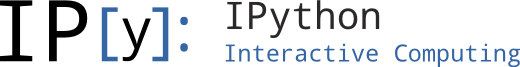

In [5]:
i

Vous pouvez aussi passer un objet avec une représentation riche à `display`:

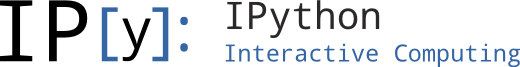

In [6]:
display(i)

Une image peut également être affichée à partir d'une URL.

In [7]:
Image(url='http://python.org/images/python-logo.gif')

Les images SVG sont également prises en charge

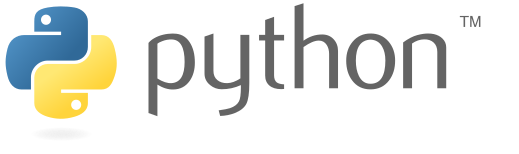

In [8]:
from IPython.display import SVG
SVG(filename='python_logo.svg')


### Images embarquées ou non intégrées

Par défaut, les données d'image sont incorporées dans le document du bloc-notes afin que les images puissent être consultées hors ligne. Cependant, il est également possible de dire à la classe `Image` de ne stocker qu'un lien vers l'image. Voyons comment cela fonctionne en utilisant une webcam à Berkeley.

In [17]:
from IPython.display import Image
img_url = 'http://www.lawrencehallofscience.org/static/scienceview/scienceview.berkeley.edu/html/view/view_assets/images/newview.jpg'

# by default Image data are embedded
Embed      = Image(img_url)

# if kwarg `url` is given, the embedding is assumed to be false
SoftLinked = Image(url=img_url, embed=False)

# In each case, embed can be specified explicitly with the `embed` kwarg
# ForceEmbed = Image(url=img_url, embed=True)

Voici la version embarquée. Notez que cette image a été extraite de la webcam lorsque cette cellule de code a été initialement exécutée et stockée dans le bloc-notes. À moins que nous ne réexécutions cette cellule, ce n'est pas l'image d'aujourd'hui.

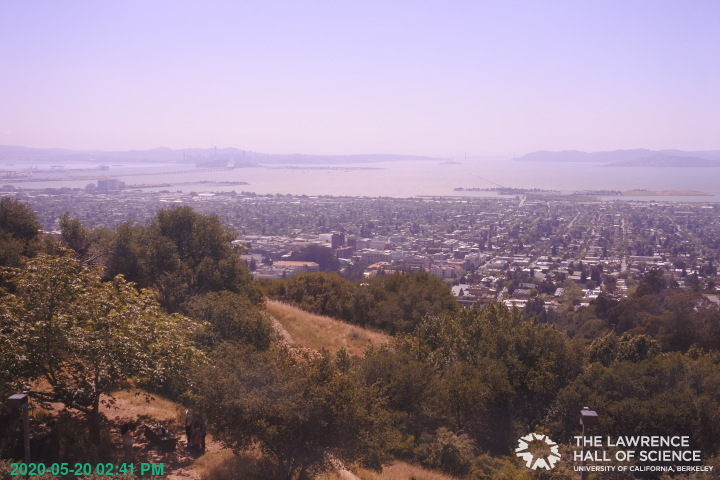

In [20]:
Embed

Voici l'image d'aujourd'hui de la même webcam à Berkeley, (actualisée toutes les minutes, si vous rechargez le portable), visible uniquement avec une connexion Internet active, qui devrait être différente de la précédente. Les blocs-notes enregistrés avec ce type d'image seront plus petits et refléteront toujours la version actuelle de la source, mais l'image ne s'affichera pas hors ligne.

In [24]:
SoftLinked = Image(url=img_url, embed=False)
SoftLinked

## HTML

Les objets Python peuvent déclarer des représentations HTML qui seront affichées dans le bloc-notes. Si vous souhaitez afficher du code HTML, utilisez simplement la classe `HTML`.

In [25]:
from IPython.display import HTML

In [26]:
s = """<table>
<tr>
<th>Header 1</th>
<th>Header 2</th>
</tr>
<tr>
<td>row 1, cell 1</td>
<td>row 1, cell 2</td>
</tr>
<tr>
<td>row 2, cell 1</td>
<td>row 2, cell 2</td>
</tr>
</table>"""

In [27]:
h = HTML(s)

In [28]:
display(h)

Header 1,Header 2
"row 1, cell 1","row 1, cell 2"
"row 2, cell 1","row 2, cell 2"


Vous pouvez également utiliser le code magique `%%html` pour accomplir la même chose.

In [29]:
%%html
<table>
<tr>
<th>Header 1</th>
<th>Header 2</th>
</tr>
<tr>
<td>row 1, cell 1</td>
<td>row 1, cell 2</td>
</tr>
<tr>
<td>row 2, cell 1</td>
<td>row 2, cell 2</td>
</tr>
</table>

Header 1,Header 2
"row 1, cell 1","row 1, cell 2"
"row 2, cell 1","row 2, cell 2"


## JavaScript

Le bloc-notes permet également aux objets de déclarer une représentation JavaScript. Au début, cela peut sembler étrange car la sortie est intrinsèquement visuelle et JavaScript est un langage de programmation. Cependant, cela ouvre la porte à une sortie riche qui exploite toute la puissance de JavaScript et des bibliothèques associées telles que [d3.js](http://d3js.org) pour la sortie.

In [65]:
from IPython.display import Javascript

Passez une chaîne de code source JavaScript à l'objet `JavaScript`, puis affichez-le.

In [31]:
js = Javascript('alert("hi")');

In [32]:
display(js)

<IPython.core.display.Javascript object>

La même chose peut être accomplie en utilisant le code magique `%%javascript`:

In [47]:
%%javascript

alert("hi");
var a = 3;

<IPython.core.display.Javascript object>

A ce jour les focntionnalités Javascript qui fonctionnent avec Binder ne sont pas supportée sur Lycée Conencté !

## LaTeX

Le système d'affichage IPython a également une prise en charge intégrée pour l'affichage d'expressions mathématiques en LaTeX, qui est rendu dans le navigateur à l'aide de [MathJax](http://mathjax.org).

Vous pouvez passer le texte brut LaTeX sous forme de chaîne à l'objet `Math`:

In [70]:
from IPython.display import Math
Math(r'F(k) = \int_{-\infty}^{\infty} f(x) e^{2\pi i k} dx')

<IPython.core.display.Math object>

Avec la classe `Latex`, vous devez inclure les délimiteurs vous-même. Cela vous permet d'utiliser d'autres modes LaTeX tels que `eqnarray`:

In [71]:
from IPython.display import Latex
Latex(r"""\begin{eqnarray}
\nabla \times \vec{\mathbf{B}} -\, \frac1c\, \frac{\partial\vec{\mathbf{E}}}{\partial t} & = \frac{4\pi}{c}\vec{\mathbf{j}} \\
\nabla \cdot \vec{\mathbf{E}} & = 4 \pi \rho \\
\nabla \times \vec{\mathbf{E}}\, +\, \frac1c\, \frac{\partial\vec{\mathbf{B}}}{\partial t} & = \vec{\mathbf{0}} \\
\nabla \cdot \vec{\mathbf{B}} & = 0 
\end{eqnarray}""")

<IPython.core.display.Latex object>

Vous pouvez aussi entrer LaTeX directement avec le code magique `%%latex`:

In [72]:
%%latex
\begin{align}
\nabla \times \vec{\mathbf{B}} -\, \frac1c\, \frac{\partial\vec{\mathbf{E}}}{\partial t} & = \frac{4\pi}{c}\vec{\mathbf{j}} \\
\nabla \cdot \vec{\mathbf{E}} & = 4 \pi \rho \\
\nabla \times \vec{\mathbf{E}}\, +\, \frac1c\, \frac{\partial\vec{\mathbf{B}}}{\partial t} & = \vec{\mathbf{0}} \\
\nabla \cdot \vec{\mathbf{B}} & = 0
\end{align}

<IPython.core.display.Latex object>

## Audio

IPython facilite le travail interactif avec les sons. La classe d'affichage `Audio` vous permet de créer un contrôle audio intégré au bloc-notes. L'interface est analogue à l'interface de la classe d'affichage `Image`. 
Tous les formats audio pris en charge par le navigateur peuvent être utilisés. Notez qu'aucun format unique n'est actuellement pris en charge dans tous les navigateurs.

In [73]:
from IPython.display import Audio
Audio(url="http://www.nch.com.au/acm/8k16bitpcm.wav")

Un tableau NumPy peut être auralisé automatiquement. La classe `Audio` normalise et code les données et incorpore l'audio résultant dans le bloc-notes.

Par exemple, lorsque deux ondes sinusoïdales de presque la même fréquence sont superposées, un phénomène appelé battements se produit. Cela peut être vérifié comme suit:

In [74]:
#install numpy
import sys
!{sys.executable} -m pip install numpy

     |████████████████████████████████| 20.2 MB 22.2 MB/s eta 0:00:01   |█████████▍                      | 5.9 MB 8.1 MB/s eta 0:00:02     |███████████                     | 7.0 MB 8.1 MB/s eta 0:00:02     |███████████████████▏            | 12.1 MB 8.1 MB/s eta 0:00:01


In [81]:
import numpy as np
max_time = 3
f1 = 220.0
f2 = 224.0
rate = 8000
L = 3
times = np.linspace(0,L,rate*L)
signal = np.sin(2*np.pi*f1*times) + np.sin(2*np.pi*f2*times)

Audio(data=signal, rate=rate)

## Video

Des objets plus exotiques peuvent également être affichés, tant que leur représentation prend en charge le protocole d'affichage IPython. Par exemple, les vidéos hébergées en externe sur YouTube sont faciles à charger :

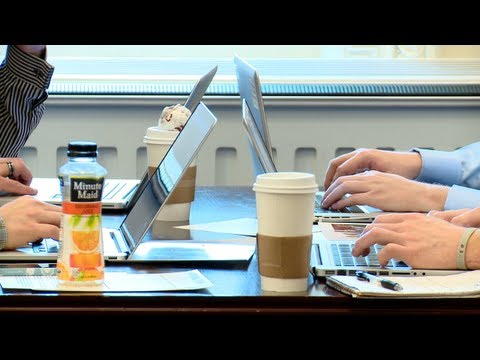

In [82]:
from IPython.display import YouTubeVideo
YouTubeVideo('sjfsUzECqK0')

En utilisant les capacités vidéo des navigateurs modernes, vous pouvez également afficher des vidéos locales. 

In [83]:
from IPython.display import HTML
from base64 import b64encode
with open("Simnet01.mp4", "rb") as f:
    video = f.read()
video_encoded = b64encode(video).decode('ascii')
video_tag = '<video controls alt="test" src="data:video/x-m4v;base64,{0}">'.format(video_encoded)
HTML(data=video_tag)

## Sites externes 

Vous pouvez même intégrer une page entière d'un autre site dans un iframe; par exemple :

In [63]:
from IPython.display import IFrame
IFrame('https://www.lyceedesgraves.fr/', width='100%', height=350)

## Liens vers des fichiers locaux

IPython fournit des classes d'affichage intégrées pour générer des liens vers des fichiers locaux. Créez un lien vers un fichier unique à l'aide de l' objet `FileLink` :

In [85]:
from IPython.display import FileLink, FileLinks
FileLink('Cell Magics.ipynb')

/home/jovyan/work/Cell Magics.ipynb

De la même manière pour générer des liens vers tous les fichiers d'un répertoire, utilisez l'objet `FileLinks`, en passant `'.'` pour indiquer que nous voulons que des liens soient générés pour le répertoire de travail actuel. Notez que s'il y avait d'autres répertoires sous le répertoire actuel, `FileLinks` cela fonctionnerait de manière récursive en créant également des liens vers des fichiers dans tous les sous-répertoires.

In [86]:
FileLinks('.')

./
  Cell Magics.ipynb
  Simnet01.mp4
  Sorties_Riches.ipynb
  python_logo.svg
  ipython_logo.png
  Exemple_01.ipynb
./.ipynb_checkpoints/
  Exemple_01-checkpoint.ipynb
  Sorties_Riches-checkpoint.ipynb
  Cell Magics-checkpoint.ipynb